<a href="https://colab.research.google.com/github/Aryan625/Object-Detection/blob/main/Object_Detection_(SSD_MobileNet_V2_FPNLite_640x640).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Installation
Installing the Tensorflow 2 Object Detection API

In [ ]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 68492, done.
remote: Counting objects: 100% (44/44), done.
remote: Compressing objects: 100% (38/38), done.
remote: Total 68492 (delta 22), reused 19 (delta 6), pack-reused 68448
Receiving objects: 100% (68492/68492), 576.98 MiB | 36.44 MiB/s, done.
Resolving deltas: 100% (48251/48251), done.


In [ ]:
%cd /content/models/research/
# The Tensorflow Object Detection API uses Protobufs to configure model and training parameters
!protoc object_detection/protos/*.proto --python_out=.
# Install TensorFlow Object Detection API.
!cp object_detection/packages/tf2/setup.py .
!python -m pip install .

/content/models/research
Processing /content/models/research
  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
     |████████████████████████████████| 9.9 MB 1.7 MB/s 
     |████████████████████████████████| 352 kB 76.1 MB/s 
     |████████████████████████████████| 1.8 MB 59.3 MB/s 
     |████████████████████████████████| 23.1 MB 43.5 MB/s 
     |████████████████████████████████| 1.2 MB 68.1 MB/s 
     |████████████████████████████████| 213 kB 35.7 MB/s 
     |████████████████████████████████| 47.7 MB 80.8 MB/s 
     |████████████████████████████████| 43 kB 2.9 MB/s 
     |████████████████████████████████| 4.9 MB 55.5 MB/s 
     |████████████████

####Test the Installation

In [ ]:
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py

Running tests under Python 3.7.12: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
2022-01-21 17:00:22.037808: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
W0121 17:00:22.390088 140048181118848 model_builder.py:1100] Building experimental DeepMAC meta-arch. Some features may be omitted.
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 2.82s
I0121 17:00:22.627881 140048181118848 test_util.py:2309] time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 2.82s
[       OK ] ModelBuilderTF2Test.test_create_center_net_deepmac
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)): 0.5s
I0121 17:00:23.126502 140048181118848 test_

---

###	Getting and processing the Kangaroo dataset available on Kaggle

In [ ]:
!pip install -q kaggle
!pip install -q kaggle-cli

     |████████████████████████████████| 74 kB 3.2 MB/s 
     |████████████████████████████████| 4.2 MB 21.5 MB/s 
     |████████████████████████████████| 149 kB 56.6 MB/s 
     |████████████████████████████████| 49 kB 8.1 MB/s 
     |████████████████████████████████| 112 kB 76.7 MB/s 
  ERROR: Failed building wheel for lxml
    Running setup.py install for lxml ... error
ERROR: Command errored out with exit status 1: /usr/bin/python3 -u -c 'import io, os, sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-q54jtgdv/lxml_786dee937dfd4cc99f44a6b6695c2553/setup.py'"'"'; __file__='"'"'/tmp/pip-install-q54jtgdv/lxml_786dee937dfd4cc99f44a6b6695c2553/setup.py'"'"';f = getattr(tokenize, '"'"'open'"'"', open)(__file__) if os.path.exists(__file__) else io.StringIO('"'"'from setuptools import setup; setup()'"'"');code = f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' install --record /tmp/pip-record-byeztjy2/install-record.txt --s

In [ ]:
import os
os.environ['KAGGLE_USERNAME'] = 'a****5'
os.environ['KAGGLE_KEY'] = '9*****************a'

#### Download and unzip the dataset to `content/dataset/` 

In [ ]:
%%bash
mkdir /content/dataset
cd /content/dataset
kaggle datasets download -d hugozanini1/kangaroodataset --unzip

100%|##########| 72.6M/72.6M [00:00<00:00, 79.5MB/s]


##### Inside a `label_map.pbtxt` file, make a label for kangaroo:



```
item {
  name: "kangaroo"
  id: 1
}
```

In [ ]:
%cd /content/
!touch label_map.pbtxt

/content


##### Converting data to TFRecord
The dataset contains two files `train_labels.csv` and `test_labels.csv` which need to be converted into TFRecord format so that it can be fed into Tensorflow’s 2 Object Detection API.

In [ ]:
!cp /content/dataset/generate_tf_records.py /content

In [ ]:
!python3 /content/generate_tf_records.py -l /content/label_map.pbtxt -o /content/dataset/train.record -i /content/dataset/images -csv /content/dataset/train_labels.csv
!python3 /content/generate_tf_records.py -l /content/label_map.pbtxt -o /content/dataset/test.record -i /content/dataset/images -csv /content/dataset/test_labels.csv

INFO:Successfully created the TFRecords: /content/dataset/train.record
INFO:Successfully created the TFRecords: /content/dataset/test.record


---

## Configuring a Training Job

#### Download Pre-Trained Model
The next step is to download and untar the pretrained TF2 SSD MobileNet V2 FPNLite 640x640.


In [ ]:
%cd /content
# Downloading SSD MobileNet V2 FPNLite 640x640 weights
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz
!tar -xvf ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz
!rm ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz

/content
--2022-01-21 17:09:39--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 74.125.142.128, 2607:f8b0:400e:c08::80
Connecting to download.tensorflow.org (download.tensorflow.org)|74.125.142.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20518283 (20M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_fp 100%[===================>]  19.57M  53.7MB/s    in 0.4s    

2022-01-21 17:09:39 (53.7 MB/s) - ‘ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz’ saved [20518283/20518283]

ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8/
ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8/checkpoint/
ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8/checkpoint/checkpoint
ssd_mobilenet_v2_fpnlite_640x640_co

In [ ]:
# Moving the configuration file from `content/models/research/object_detection/configs/tf2/` to `content/`
!cp /content/models/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.config /content/

### Configure the Training Pipeline

In [ ]:
# Define training parameters

num_classes = 1
batch_size = 8
num_steps = 7500
num_eval_steps = 1000

train_record_path = '/content/dataset/train.record'
test_record_path = '/content/dataset/test.record'
model_dir = '/content/training/'
labelmap_path = '/content/label_map.pbtxt'

fine_tune_checkpoint_type = 'detection'
pipeline_config_path = '/content/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.config'
fine_tune_checkpoint = '/content/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8/checkpoint/ckpt-0'

Editing config file

In [ ]:
import re

with open(pipeline_config_path) as f:
    config = f.read()

with open(pipeline_config_path, 'w') as f:

  # Set labelmap path
  config = re.sub('label_map_path: ".*?"', 
  'label_map_path: "{}"'.format(labelmap_path), config)
  
  # Set fine_tune_checkpoint path
  config = re.sub('fine_tune_checkpoint: ".*?"',
                  'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint),
                  config)

  # Set fine_tune_checkpoint_type
  config = re.sub('fine_tune_checkpoint_type: ".*?"',
                  'fine_tune_checkpoint_type: "{}"'.format(fine_tune_checkpoint_type),
                  config)  
  
  # Set train tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 
                  'input_path: "{}"'.format(train_record_path), config)
  
  # Set test tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 
                  'input_path: "{}"'.format(test_record_path), config)
  
  # Set number of classes.
  config = re.sub('num_classes: [0-9]+',
                  'num_classes: {}'.format(num_classes), config)
  
  # Set batch size
  config = re.sub('batch_size: [0-9]+',
                  'batch_size: {}'.format(batch_size), config)
  
  # Set training steps
  config = re.sub('num_steps: [0-9]+',
                  'num_steps: {}'.format(num_steps), config)
  
  f.write(config)

---

In [ ]:
# The code below deals with the latest error encounterd during training the model 
!pip uninstall opencv-python-headless==4.5.5.62
!pip install opencv-python-headless==4.1.2.30

Found existing installation: opencv-python-headless 4.5.5.62
Uninstalling opencv-python-headless-4.5.5.62:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/cv2/*
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless-4.5.5.62.dist-info/*
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libavcodec-64ac49e1.so.58.91.100
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libavformat-4b79e479.so.58.45.100
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libavutil-805734e8.so.56.51.100
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libbz2-a273e504.so.1.0.6
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libcrypto-018b8c17.so.1.1
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libgfortran-91cc3cb1.so.3.0.0
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless.libs/libopenblas-r0-f650aae0.3.3.so
    /usr/local/lib/python3.7/dist

### Training the Model
The model is trained for 7500 steps

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_config_path} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2022-01-21 17:15:15.639725: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I0121 17:15:15.643716 140408778127232 mirrored_strategy.py:376] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 7500
I0121 17:15:15.648715 140408778127232 config_util.py:552] Maybe overwriting train_steps: 7500
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0121 17:15:15.648891 140408778127232 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W0121 17:15:15.677479 140408778127232 deprecation.py:347] From /usr/local/lib/python3.7/dist-packages/object_detection/model_lib_v2.py:564: StrategyBase.experiment

---

## Evaluating the Model

Here the code runs through a loop that waits for checkpoints to evaluate. Once the evaluation finishes, below message can be seen:

`INFO:tensorflow:Waiting for new checkpoint at /content/training/`

Then the cell can be stoped


In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_config_path} \
    --model_dir={model_dir} \
    --checkpoint_dir={model_dir}           ##This is passed to run ONLY EVALUATION

W0121 18:33:48.018486 140174302447488 model_lib_v2.py:1090] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I0121 18:33:48.019641 140174302447488 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0121 18:33:48.019769 140174302447488 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0121 18:33:48.019863 140174302447488 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0121 18:33:48.020001 140174302447488 model_lib_v2.py:1111] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2022-01-21 18:33:48.730006: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original confi

---

## Monitor Training Job Progress using TensorBoard
Training and validation Metrics 

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/training/'

<IPython.core.display.Javascript object>

## Run Model inference on test images

In [ ]:
output_directory = '/content/inference_graph/'

!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {model_dir} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_config_path}

2022-01-21 18:56:47.480443: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0121 18:56:47.716527 139842880227200 deprecation.py:619] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:464: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0121 18:57:02.474028 13984288022

####  Testing the trained model

Based on Object Detection API Demo and Inference from saved model tf2 colab

In [ ]:
!wget https://raw.githubusercontent.com/hugozanini/object-detection/master/inferenceutils.py
from inferenceutils import *

--2022-01-21 18:57:53--  https://raw.githubusercontent.com/hugozanini/object-detection/master/inferenceutils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2219 (2.2K) [text/plain]
Saving to: ‘inferenceutils.py’

inferenceutils.py   100%[===================>]   2.17K  --.-KB/s    in 0s      

2022-01-21 18:57:53 (41.2 MB/s) - ‘inferenceutils.py’ saved [2219/2219]



##### Loading the model

In [ ]:
output_directory = '/content/inference_graph/'

In [ ]:
category_index = label_map_util.create_category_index_from_labelmap(labelmap_path, use_display_name=True)
tf.keras.backend.clear_session()
model = tf.saved_model.load(f'{output_directory}/saved_model')

##### Selecting the images to test

In [ ]:
import pandas as pd
test = pd.read_csv('dataset/test_labels.csv')
images = list(test['filename'][0:20])

##### Doing inference

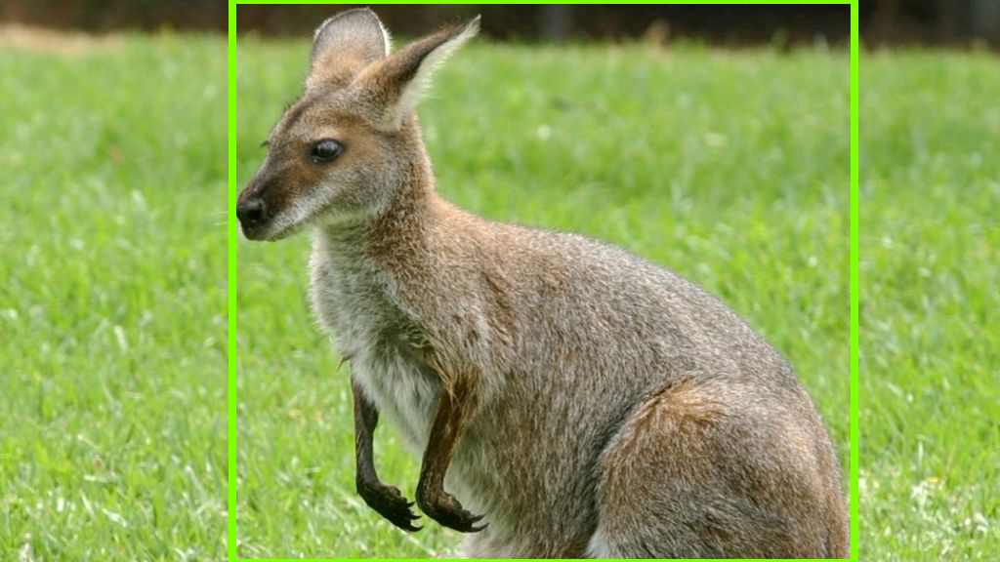

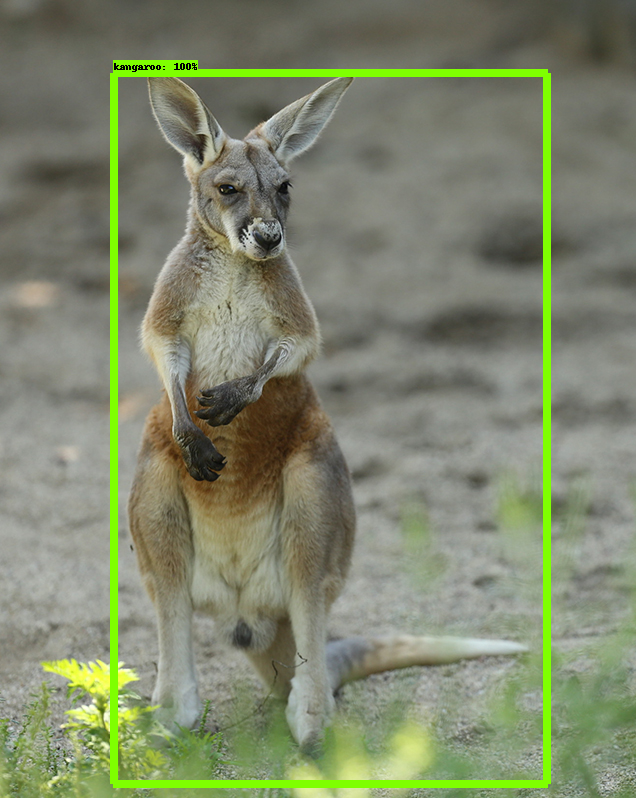

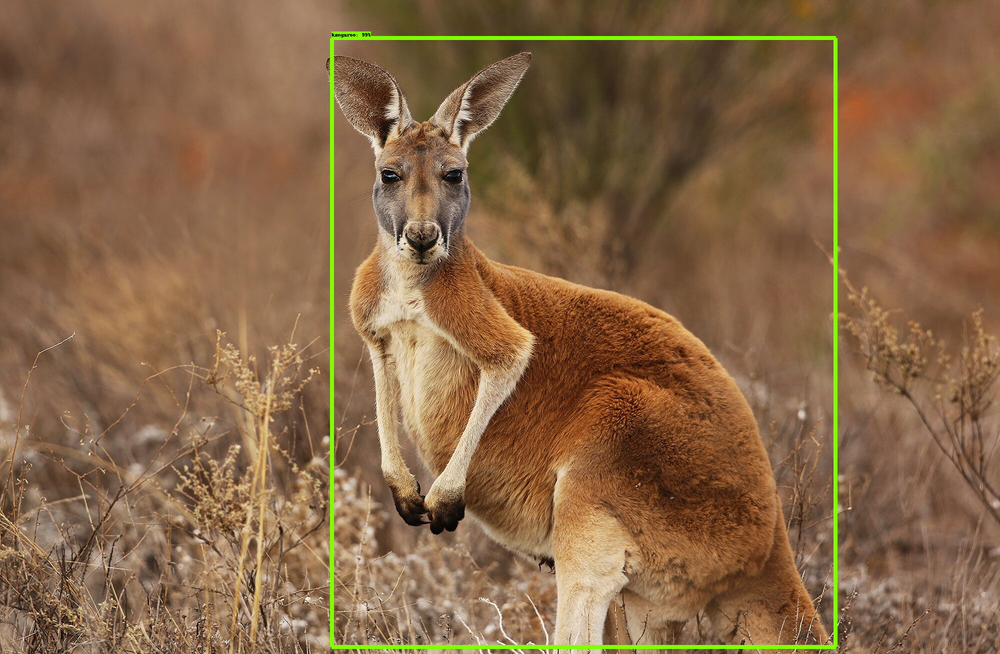

In [ ]:
images = ['kangaroo-10.jpg', 'kangaroo-21.jpg', 'kangaroo-3.jpg']

for image_name in images:
  
  image_np = load_image_into_numpy_array('/content/dataset/images/' + image_name)
  output_dict = run_inference_for_single_image(model, image_np)
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)
  display(Image.fromarray(image_np))

---